# 1. Loading the data and creating sample

In [57]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import pickle

# For visualization with Yellowbrick
#from yellowbrick.features import PCA as YBPCA

df = pd.read_csv('project/creditcard.csv')

#Creating a sample dataset
pos_records = df[df['Class'] == 1]
neg_records = df[df['Class'] == 0].sample(len(pos_records))

exmpl_df = pd.concat([pos_records, neg_records], ignore_index=True)
print(exmpl_df)

         Time        V1        V2        V3        V4        V5        V6  \
0       406.0 -2.312227  1.951992 -1.609851  3.997906 -0.522188 -1.426545   
1       472.0 -3.043541 -3.157307  1.088463  2.288644  1.359805 -1.064823   
2      4462.0 -2.303350  1.759247 -0.359745  2.330243 -0.821628 -0.075788   
3      6986.0 -4.397974  1.358367 -2.592844  2.679787 -1.128131 -1.706536   
4      7519.0  1.234235  3.019740 -4.304597  4.732795  3.624201 -1.357746   
..        ...       ...       ...       ...       ...       ...       ...   
979   59224.0 -0.791638 -0.035988  1.294740 -0.510967 -0.777317 -0.129579   
980   43390.0 -1.357508 -0.314993  2.113398 -1.995089 -1.666342 -0.358175   
981   78883.0  1.184662 -0.216035  0.651774 -0.168070 -0.769154 -0.379905   
982  139734.0 -1.038651  0.967426 -1.302703 -0.899374  1.529832  1.138201   
983   50711.0  1.076024 -0.128304  1.309235  1.285329 -0.896451  0.382476   

           V7        V8        V9  ...       V21       V22       V23  \
0  

## Checking the missing values

In [21]:
#All dataframe
df.info()
df.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

# 2. Visualization of the distribution

In [22]:
sns.pairplot(exmpl_df, hue="Class", diag_kind="kde")
plt.show()

# 3. Detect correlations


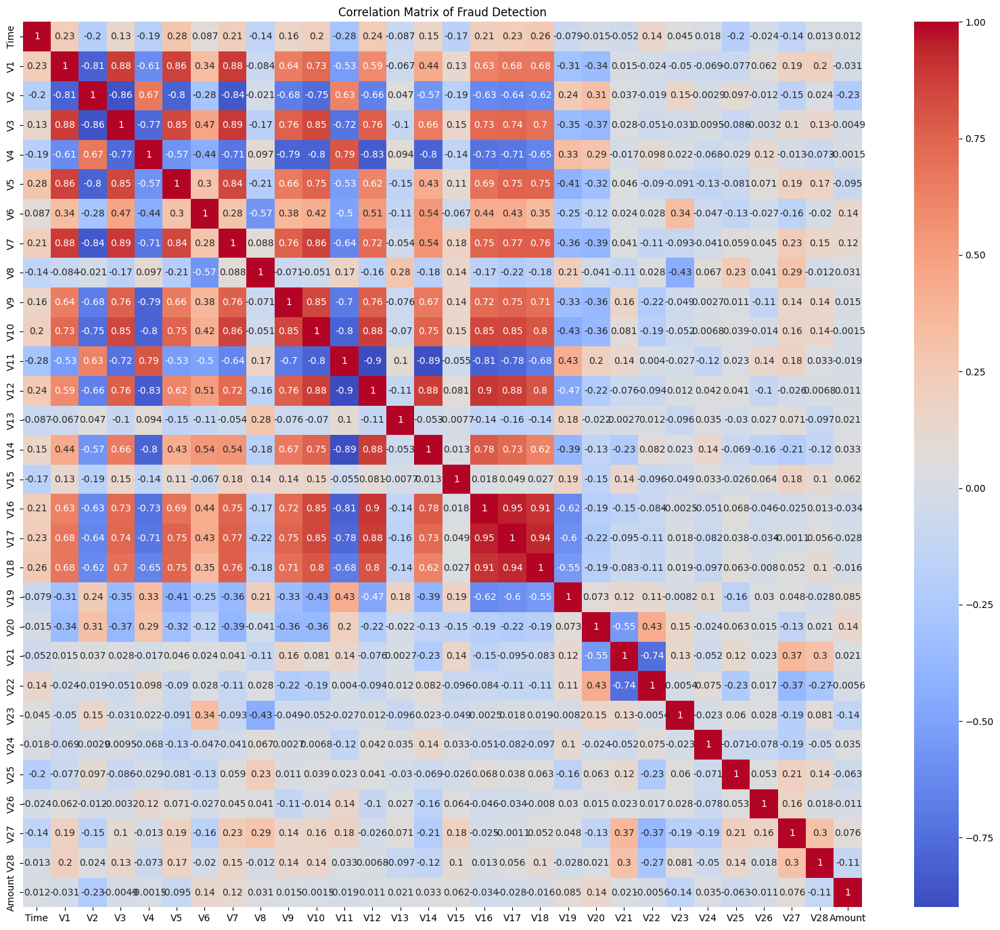

In [53]:
plt.figure(figsize=(20,17))
sns.heatmap(exmpl_df.drop("Class", axis=1).corr(), annot=True, cmap="coolwarm")
plt.title("Correlation Matrix of Fraud Detection")
plt.show()


# 4. Label Analysis (Class distribution)

Class
1    492
0    492
Name: count, dtype: int64


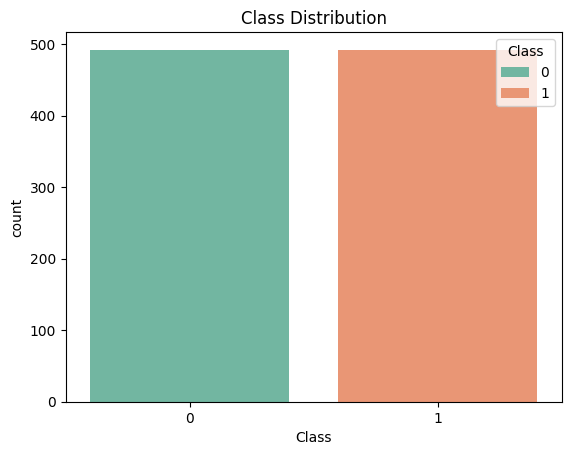

In [27]:
print(exmpl_df['Class'].value_counts())
sns.countplot(x='Class', data=exmpl_df, hue='Class', palette="Set2")
plt.title("Class Distribution")
plt.show()

# Summary statistics by class

In [28]:
exmpl_df.groupby("Class").describe().T

Class                    0             1
Time   count    492.000000    492.000000
       mean   91654.817073  80746.806911
       std    47143.566030  47835.365138
       min      458.000000    406.000000
       25%    49551.750000  41241.500000
...                    ...           ...
Amount min        0.000000      0.000000
       25%        7.777500      1.000000
       50%       23.610000      9.250000
       75%       82.702500    105.890000
       max     1529.650000   2125.870000

[240 rows x 2 columns]

# Data standarization and fitting PCA

In [ ]:
#PCA (te połączenia cech najlepiej tłumaczą zmienność danych)
X = exmpl_df.drop(columns=['Time', 'Amount', 'Class'])
Y = exmpl_df['Class']

X_scaled = StandardScaler().fit_transform(X)
pca = PCA(n_components=28)
X_pca = pca.fit_transform(X_scaled)

explained_var = pca.explained_variance_ratio_
print("Explained variance ratio by each principal component:", explained_var)
print("Total explained variance:", explained_var.sum())

Explained variance ratio by each principal component: [0.40490487 0.10610439 0.07505564 0.05721256 0.05367498 0.04031558
 0.03656749 0.03266924 0.0310517  0.02540657 0.02348544 0.0190428
 0.01742608 0.0144588  0.01158391 0.00940756 0.00834072 0.00653935
 0.00486661 0.00427078 0.00370687 0.00318818 0.00243533 0.00204939
 0.00199181 0.00169991 0.00148246 0.00106097]
Total explained variance: 1.0


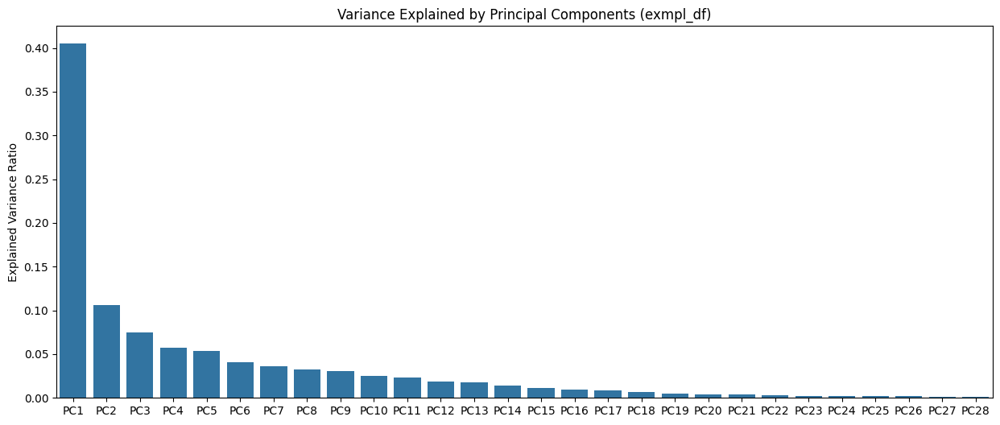

In [55]:
plt.figure(figsize=(15,6))
sns.barplot(x=[f"PC{i+1}" for i in range(len(explained_var))], y=explained_var)
plt.ylabel("Explained Variance Ratio")
plt.title("Variance Explained by Principal Components (exmpl_df)")
plt.show()

In [40]:
pca_80 = PCA(n_components=0.8)
X_pca_80 = pca_80.fit_transform(X_scaled)
print("Number of components that explains 80% variance:", pca_80.n_components_)

Number of components that explains 80% variance: 8


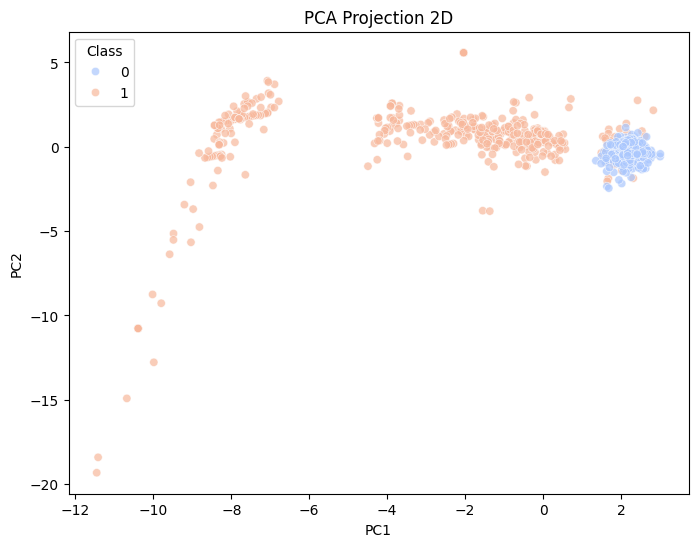

In [52]:
pca_df = pd.DataFrame(X_pca_80[:, :2], columns=['PC1', 'PC2'])
pca_df['Class'] = Y.values

plt.figure(figsize=(8,6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Class', palette='coolwarm', alpha=0.7)
plt.title('PCA Projection 2D')
plt.show()


In [56]:
X_reduced = X_pca_80
print(X_reduced)


[[-0.14075322  0.32389911  0.50060273 ... -0.04752862 -0.33355697
   1.00532349]
 [ 2.00319466 -0.46067994  0.38472486 ...  1.91465892  0.63805788
  -0.46320836]
 [ 0.48509948 -0.06796098 -0.51002202 ... -1.21252244 -0.49729669
  -0.65636756]
 ...
 [ 2.41593248 -0.43381519 -0.60601759 ... -1.13778619 -0.28083529
  -0.46678213]
 [ 2.05696448  0.01022438  0.14500966 ...  0.41837129 -0.01644634
   0.29234577]
 [ 2.17354525 -0.53214075  0.16224773 ... -0.00255142 -0.0669395
  -1.15693291]]


# Linear Correlation Heatmap

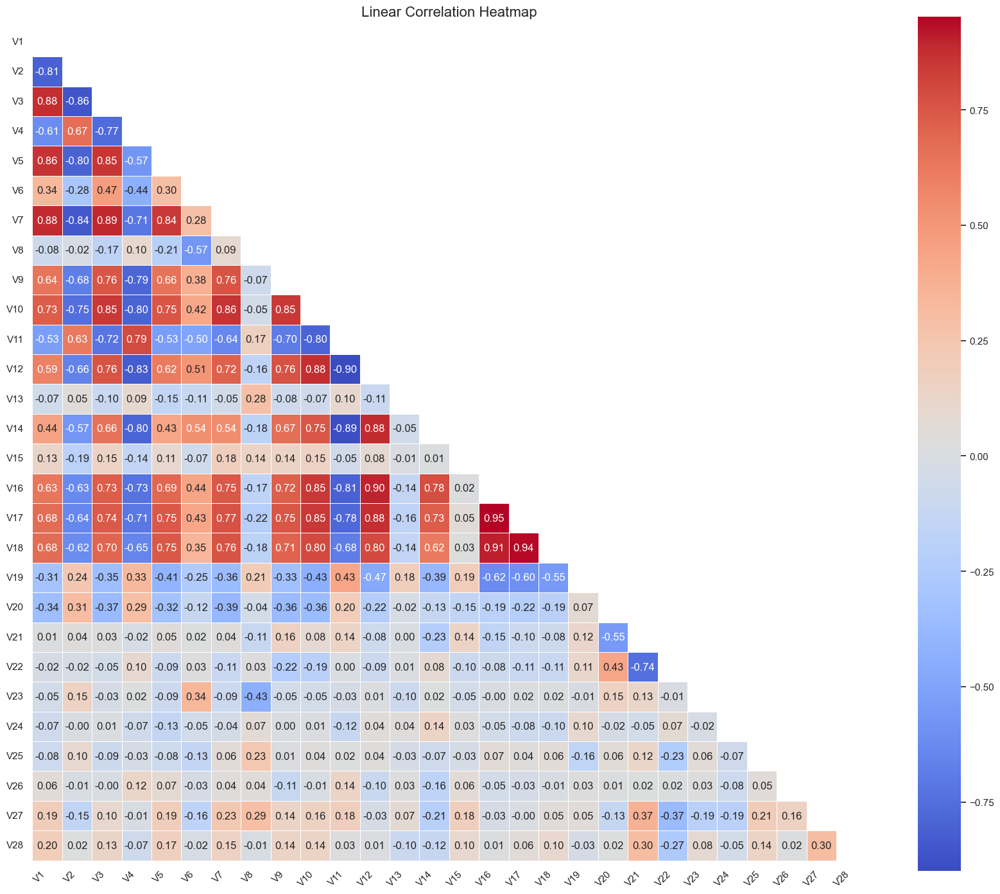

In [59]:
sns.set_theme(style="white")
numeric_df = X
corr = X.corr(numeric_only=True)
mask = np.triu(corr)
plt.figure(figsize=(17,17))
sns.heatmap(corr, mask=mask, annot=True, fmt=".2f", cmap="coolwarm", cbar_kws={"shrink": .8}, linewidths=0.5, square=True)

plt.title("Linear Correlation Heatmap", fontsize=16, pad=12)
plt.xticks(rotation=45, ha="right")
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()
